# GAN-DALF

#### generation 1 training

parent models: DCGAN celeba & GAN sorted originals

#### Hannah Reber

Graduation Project Ironhack Berlin Data Science

Oct. 2020

## initialize: session storages

In [1]:
# storages and counters for training runs
img_list = []
G_losses = []
D_losses = []
nptrans_list = []
iters = 0

# save pics of session
fakepics = []

# count runs of this sesion
runcount = 0

# save settings of each run
savesettings = dict()

# clock storage
session_clocks = []
clock_count = 0

# import: packages

In [2]:
from __future__ import print_function
%matplotlib inline
import os
import random
import argparse
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import glob
import cv2
import copy
import pickle
import numba
import sklearn
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.onnx
import torch.onnx as torch_onnx
import torch.utils.data
import torchvision
from torchvision import  models, transforms
from torchvision.transforms import ToPILImage
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torchvision.utils import save_image
import PIL
from PIL import Image
import skimage.io as io
from skimage import data_dir,io,color
import json
import time 
import datetime
from datetime import date
import pprint
timehour = time.localtime().tm_hour
timemin = time.localtime().tm_min
today = date.today().day
month = date.today().month
sessionid = str(month)+ "-" +str(today)

# check: cuda

In [3]:
torch.cuda.is_available()

True

In [4]:
torch.cuda.get_device_capability()

(5, 2)

# functions: clock and plots

In [7]:
def clock():
    h = time.localtime().tm_hour
    h = str(h)
    m = time.localtime().tm_min
    m = str(m)
    if len(m)==1:
        m = "0"+m
    return h+":"+m

In [ ]:
# plot funcs

def bigplotrealbatch():
    real_batch = next(iter(dataloader))
    plt.figure(figsize=(20,20))
    plt.axis("off")
    plt.title("Training Images")
    plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
    
def plotloss():
    plt.figure(figsize=(10,5))
    plt.title("Generator and Discriminator Loss During Training")
    plt.plot(G_losses,label="G")
    plt.plot(D_losses,label="D")
    plt.xlabel("iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

def plot_input_output():    
# batch of input images from dataloader
    real_batch = next(iter(dataloader))
    plt.figure(figsize=(15,15))
    plt.subplot(1,2,1)
    plt.axis("off")
    plt.title("Real Images")
    plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))
# batch of generated pics from the last epoch
    fakebatch = next(iter(img_list))
    plt.subplot(1,2,2)
    plt.axis("off")
    plt.title("Fake Images")
    plt.imshow(np.transpose(img_list[-1],(1,2,0)))
    plt.show()

In [ ]:
# func to save generated pics locally
def save_gandalfs_pics(indexnum,size):
    plt.figure(figsize=(size,size))
    name= namesnames.get(img_list[indexnum])
    plt.axis("off")
    plt.imshow(np.transpose(img_list[indexnum],(1,2,0)))
    plt.savefig(name,dpi=300)
    plt.close()

# settings: seed

In [11]:
# set seed for reproducibility to 123
manualSeed = 123
#manualSeed = random.randint(1, 100) 
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  123


# settings: workers / batch_size / num_epochs / etc.


In [54]:
# Root directory for dataset
dataroot = "./data_input/"

# Number of workers for dataloader
workers = 4

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 50

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

# dataloader

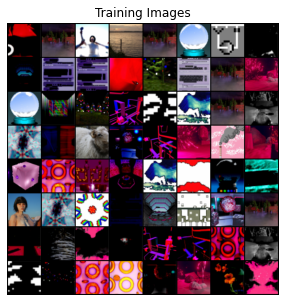

In [55]:
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers, pin_memory=True) 

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu") # keeping cpu as backup

# Confirm
plotrealbatch()

# settings: weights

In [56]:
###### Initialize WEIGHTS 
##################################

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# MODELS

In [57]:
##### NET CLASS
######################################

class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(3, 6, 5)
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(6, 16, 5)
        self.fc1 = nn.Linear(16 * 5 * 5, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 10)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = x.view(-1, 16 * 5 * 5)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x

netG = Net()
netD = Net()

In [58]:
## GENERATOR CLASS
######################################

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [59]:
###### Create the GENERATOR
######################################

netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [60]:
## DISCRIMINATOR CLASS 
######################################

class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [61]:
#####  Create the DISCRIMINATOR 
######################################

netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [62]:
##### Criterion / Losses / Optimizers
######################################

# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))


# ....................................................................................................................

# .......................................... START TRAINING ..........................................


In [14]:
newsessionid = "G1_S" + str(runcount) + sessionid
newsessionid

'G1_S010-16'

In [64]:
################################################################################################################################
# CUSOMIZE RUN SETTINGS HERE
################################################################################################################################

workers = 4
batch_size = 128
num_epochs = 50
# lr = 0.1 # Learning rate for optimizers
# beta1 = 0.3 # Beta1 hyperparam for Adam optimizers
# Size of z latent vector = size of generator input nz = 100
# Size of feature maps in generator ngf = 64
# Size of feature maps in discriminator ndf = 64

# import: checkpoints netG / netD

In [17]:
##### pretrained model path
######################################
gen1 = os.getcwd() + '\\save\\gen1.pt'

In [77]:
##### load pretrained model
######################################
checkpoint = torch.load(gen1)     
netD.load_state_dict(checkpoint['netD_state_dict'])
netG.load_state_dict(checkpoint['netG_state_dict'])
optimizerD.load_state_dict(checkpoint['optimizerD_state_dict'])
optimizerG.load_state_dict(checkpoint['optimizerG_state_dict'])

In [78]:
# Gtrain
netG.train()

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

In [79]:
# Dtain
netD.train()

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

# training: netG / netD

In [80]:
##### initializes session pic storages
######################################
gridid = 0
single_nptrans_list = []

In [81]:
################################################################################################################################
################################################################################################################################
#
# START OF TRAINING RUN
#
runcount += 1
savesettings[newsessionid+"_settings"] = [["workers",workers],["epochs",num_epochs],["batchsize",batch_size],["optim_learnrate",lr],["beta1",beta1]]
print("TRAIN THAT BRAIN!")
print("\t\t\t\tclock:",clock())
####################################################################################
####################################################################################
    # for each epoche
for epoch in range(num_epochs):
        # and each batch in dataloader
    for i, data in enumerate(dataloader, 0):
####################################################################################
#  1. UPDATE D NETWORK: maximize log(D(x)) + log(1 - D(G(z)))
####################################################################################
#  1.1. train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()
        ############################################################################
#  1.2. train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()
####################################################################################
#  2. UPDATE G NETWORK: maximize log(D(G(z)))
####################################################################################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # only D is updated yet, so one more forward pass of all fakepics through D
        output = netD(fake).view(-1)
        # get G's loss based on output of forward pass of fakepics through D
        errG = criterion(output, label)
        # get gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # update G
        optimizerG.step()
        ############################################################################
# 2.1. see output training stats
        if i % 16 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch+1, num_epochs, i+1, len(dataloader), errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        ############################################################################
# 2.3. save Losses
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        ############################################################################
# 2.4. see how G is doing - save G's output on fixed_noise
        if (iters % 16 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            clock_count += 1
            c = clock()
            session_clocks.append([clock_count,c])
            print("\t\t\t\tclock:",c)
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
                fakepics.append(fake)
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            for img,labels in dataloader:
                break
            npsingles = [x for x in img.cpu().numpy()[0:]]
            nptrans = [np.transpose(x, (1,2,0)) for x in npsingles] 
            for x in nptrans:
                nptrans_list.append(x)
        ############################################################################
        iters += 1
################################################################################################################################

TRAIN THAT BRAIN!
				clock: 14:36
[1/10][1/105]	Loss_D: 0.2346	Loss_G: 9.6310	D(x): 1.0000	D(G(z)): 0.1425 / 0.0003
[1/10][26/105]	Loss_D: 0.0023	Loss_G: 7.4835	D(x): 1.0000	D(G(z)): 0.0023 / 0.0019
[1/10][51/105]	Loss_D: 0.0065	Loss_G: 7.7420	D(x): 0.9952	D(G(z)): 0.0011 / 0.0011
				clock: 14:36
[1/10][76/105]	Loss_D: 0.0020	Loss_G: 6.8859	D(x): 1.0000	D(G(z)): 0.0019 / 0.0016
[1/10][101/105]	Loss_D: 0.0030	Loss_G: 7.9547	D(x): 0.9978	D(G(z)): 0.0008 / 0.0007
[2/10][1/105]	Loss_D: 0.0041	Loss_G: 6.4243	D(x): 0.9999	D(G(z)): 0.0040 / 0.0029
				clock: 14:37
[2/10][26/105]	Loss_D: 0.0012	Loss_G: 27.3821	D(x): 0.9991	D(G(z)): 0.0003 / 0.0001
[2/10][51/105]	Loss_D: 0.0317	Loss_G: 13.5905	D(x): 1.0000	D(G(z)): 0.0263 / 0.0007
[2/10][76/105]	Loss_D: 0.0002	Loss_G: 15.5930	D(x): 1.0000	D(G(z)): 0.0002 / 0.0001
				clock: 14:37
[2/10][101/105]	Loss_D: 0.0008	Loss_G: 14.2889	D(x): 0.9997	D(G(z)): 0.0005 / 0.0003
[3/10][1/105]	Loss_D: 0.0020	Loss_G: 11.6800	D(x): 0.9998	D(G(z)): 0.0018 / 0.00

In [82]:
lossGname = newsessionid+"_LossG_mean"
lossDname = newsessionid+"_LossD_mean"
savesettings[lossGname]= sum(G_losses)/len(G_losses)
savesettings[lossDname]= sum(D_losses)/len(D_losses)
# review:
savesettings

{'10-8-13-16_G7_0_settings': [['workers', 4],
  ['epochs', 30],
  ['batchsize', 128],
  ['optim_learnrate', 0.0002],
  ['beta1', 0.5]],
 '10-8-13-16_G7_0_LossG_mean': 8.811466298577113,
 '10-8-13-16_G7_0_LossD_mean': 0.027767812657933832,
 '10-8-13-16_G7_1_settings': [['workers', 4],
  ['epochs', 10],
  ['batchsize', 128],
  ['optim_learnrate', 0.0002],
  ['beta1', 0.5]],
 '10-8-13-16_G7_1_LossG_mean': 9.270184424696168,
 '10-8-13-16_G7_1_LossD_mean': 0.03022193888065861}

# export: save model checkpoints

In [84]:
torch.save({'netD_state_dict':netD.state_dict(),
            'netG_state_dict': netG.state_dict(),
            'optimizerD_state_dict': optimizerD.state_dict(),
            'optimizerG_state_dict': optimizerG.state_dict()},gen1) 

################################################################################################################################
################################################################################################################################
################################################################################################################################
# EXPORT MODEL AFTER EACH TRAINING
################################################################################################################################
################################################################################################################################
################################################################################################################################

3


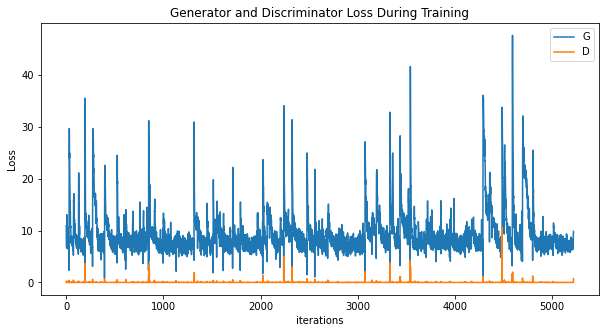

In [85]:
print(runcount)
plotloss()


 batch_size: 128 	 workers: 4 	 generated pictures: 84


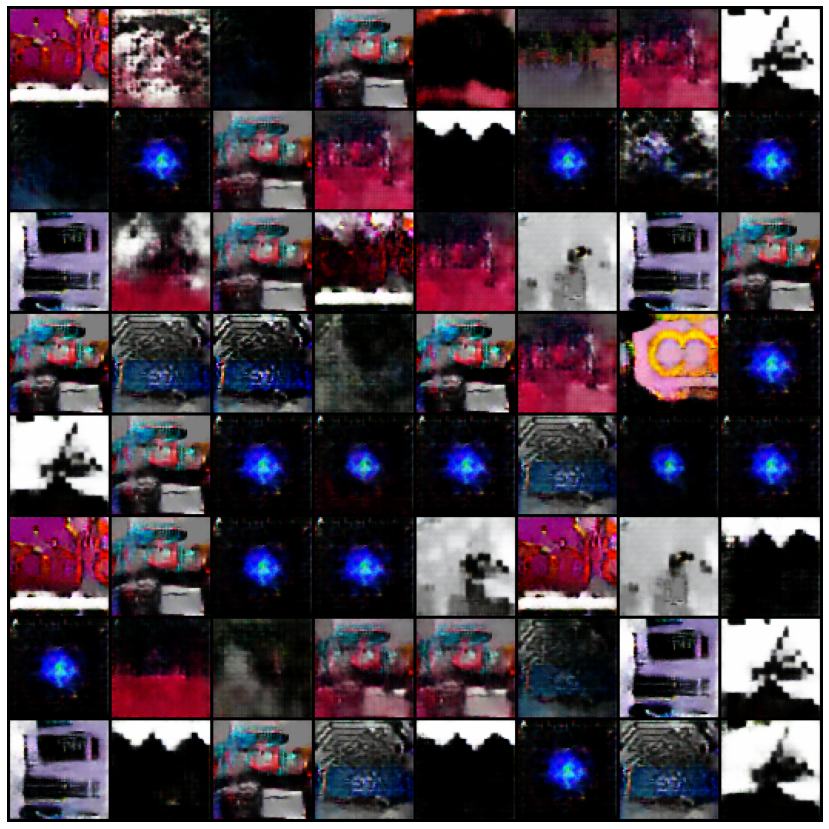

In [86]:
print("\n batch_size:", batch_size, "\t workers:",workers, "\t generated pictures:", len(img_list)-1)

#%%capture
fig = plt.figure(figsize=(10,10))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list[-10:]]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

# gallery: session fakepics and loss plot

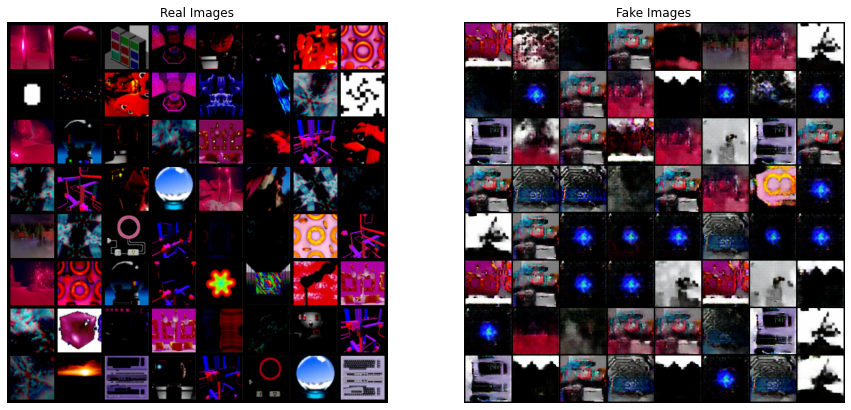

In [87]:
plot_input_output()

# export: save generated pics & losses

In [88]:
##### SAVE GENERATED PICTURE GRIDS
######################################

generated_pic_path  = os.getcwd + "\\output\\gen1_p"
picnum = [generated_pic_path + str(x[0]) for x in enumerate(img_list)]
picfiles = [x + ".jpg" for x in nummer]
picdict = dict(zip(img_list,picfiles))
    
for indexnum in [x for x in range(len(img_list))]:
    save_gandalfs_pics(indexnum,30)   

# export documentation: session df / settings / losses

In [286]:
# losses
lossdict = {"G_losses": G_losses , "D_losses": D_losses}
jsonname2 = "losses_"+newsessionid+".json"
with open(jsonname2, 'w') as file:
     file.write(json.dumps(lossdict, ensure_ascii=False))

In [52]:
# settings
jsonname1 = "settings_"+ newsessionid+".json"
with open(jsonname1, 'w') as file:
     file.write(json.dumps(savesettings, ensure_ascii=False))

In [309]:
# session df
sessiondf = pd.DataFrame(lossdict)
sessiondf['session_id'] = newsessionid
sessiondf['workers'] = workers
sessiondf['batch_size'] = batch_size
sessiondf['num_epochs'] = num_epochs
sessiondf['nz'] = nz
sessiondf['lr'] = lr
sessiondf['beta1'] = beta1
sessiondf.to_csv(newsessionid+"_settings.csv")

In [310]:
# session csv 
df = sessiondf.copy()
index = [i+1 for i in df.index]
frames = [i/250 == 0 for i in index]
df["fakepicfile"] = frames
dfname = newsessionid + "_pics.csv"
df.to_csv(dfname)

In [305]:
# overview generated files
d = {"fakepicname":picnames,"fakepic":picfiles}
picdf = pd.DataFrame(d)
dfname = sessionid + "_picids.csv"
picdf.to_csv(dfname)

# xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx